# Dự đoán biến động giá cổ phiếu

![Ảnh minh họa](https://taichinh.kinhtechungkhoan.vn/stores/news_dataimages/2023/122023/01/14/bien-dong-gia-co-phieu-320231201144846.jpg?rt=20231201144917)

# Mục lục

1. **EDA**
2. **Data Preprocessing**
3. **Modeling and Training**

- **LSTM**
- **Transformer** (Encoder)

4. **Testing**
5. **Tổng kết**

# 1. EDA

In [1]:
!pip install pandas_ta

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.1/115.1 kB 4.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pandas_ta: filename=pandas_ta-0.3.14b0-py3-none-any.whl size=218910 sha256=da729af07a89901ccb77a79c84d7d345474d79a655207c10df47fa76d87995bc
  Stored in directory: /root/.cache/pip/wheels/69/00/ac/f7fa862c34b0e2ef320175100c233377b4c558944f12474cf0
Successfully built pandas_ta


**Import Library**

In [2]:
import numpy as np
import pandas as pd
import pandas_ta as ta
import matplotlib.pyplot as plt
import seaborn as sns

import plotly as py
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

# Show charts when running kernel
init_notebook_mode(connected=True)

# Change default background color for all visualizations
layout=go.Layout(paper_bgcolor='rgba(0,0,0,0)', plot_bgcolor='rgba(250,250,250,0.8)')
fig = go.Figure(layout=layout)
templated_fig = pio.to_templated(fig)
pio.templates['my_template'] = templated_fig.layout.template
pio.templates.default = 'my_template'

import warnings
warnings.filterwarnings('ignore')

**Load Dataset**

In [3]:
# Data Path
PATH = {
    'FPT': '/kaggle/input/stock-market/FPT.csv',
    'MSN': '/kaggle/input/stock-market/MSN.csv',
    'PNJ': '/kaggle/input/stock-market/PNJ.csv',
    'VIC': '/kaggle/input/stock-market/VIC.csv'
}

In [4]:
# Load dataset
for stock in PATH.keys():
    globals()[stock] = pd.read_csv(PATH[stock], parse_dates=['Date/Time'])
    print(globals()[stock].head(3))

  Ticker           Date/Time   Open   High    Low  Close  Volume  \
0    FPT 2018-12-25 09:15:00  30.89  30.89  30.89  30.89   35410   
1    FPT 2018-12-25 09:16:00  30.81  30.81  30.81  30.81     190   
2    FPT 2018-12-25 09:17:00  30.74  30.81  30.74  30.74    1120   

   Open Interest  
0              0  
1              0  
2              0  
  Ticker           Date/Time  Open  High   Low  Close  Volume  Open Interest
0    MSN 2017-12-25 09:15:00  73.1  73.1  73.1   73.1    4210              0
1    MSN 2017-12-25 09:16:00  73.0  73.0  73.0   73.0    5000              0
2    MSN 2017-12-25 09:18:00  73.5  73.5  73.5   73.5     210              0
  Ticker           Date/Time   Open   High    Low  Close  Volume  \
0    PNJ 2018-02-28 09:15:00  78.14  78.99  78.14  78.99     270   
1    PNJ 2018-02-28 09:16:00  78.94  78.94  78.94  78.94      10   
2    PNJ 2018-02-28 09:19:00  78.14  78.14  78.14  78.14     283   

   Open Interest  
0              0  
1              0  
2            

In [5]:
FPT.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97406 entries, 0 to 97405
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   Ticker         97406 non-null  object        
 1   Date/Time      97406 non-null  datetime64[ns]
 2   Open           97406 non-null  float64       
 3   High           97406 non-null  float64       
 4   Low            97406 non-null  float64       
 5   Close          97406 non-null  float64       
 6   Volume         97406 non-null  int64         
 7   Open Interest  97406 non-null  int64         
dtypes: datetime64[ns](1), float64(4), int64(2), object(1)
memory usage: 5.9+ MB


In [6]:
MSN.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 135354 entries, 0 to 135353
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   Ticker         135354 non-null  object        
 1   Date/Time      135354 non-null  datetime64[ns]
 2   Open           135354 non-null  float64       
 3   High           135354 non-null  float64       
 4   Low            135354 non-null  float64       
 5   Close          135354 non-null  float64       
 6   Volume         135354 non-null  int64         
 7   Open Interest  135354 non-null  int64         
dtypes: datetime64[ns](1), float64(4), int64(2), object(1)
memory usage: 8.3+ MB


In [7]:
PNJ.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 125309 entries, 0 to 125308
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   Ticker         125309 non-null  object        
 1   Date/Time      125309 non-null  datetime64[ns]
 2   Open           125309 non-null  float64       
 3   High           125309 non-null  float64       
 4   Low            125309 non-null  float64       
 5   Close          125309 non-null  float64       
 6   Volume         125309 non-null  int64         
 7   Open Interest  125309 non-null  int64         
dtypes: datetime64[ns](1), float64(4), int64(2), object(1)
memory usage: 7.6+ MB


In [8]:
VIC.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101266 entries, 0 to 101265
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   Ticker         101266 non-null  object        
 1   Date/Time      101266 non-null  datetime64[ns]
 2   Open           101266 non-null  float64       
 3   High           101266 non-null  float64       
 4   Low            101266 non-null  float64       
 5   Close          101266 non-null  float64       
 6   Volume         101266 non-null  int64         
 7   Open Interest  101266 non-null  int64         
dtypes: datetime64[ns](1), float64(4), int64(2), object(1)
memory usage: 6.2+ MB


In [9]:
for stock in PATH.keys():
    # Drop Ticker
    globals()[stock].drop(columns=['Ticker'],inplace=True)
    # Set Date/Time as index
    globals()[stock].set_index('Date/Time', inplace=True)

**Dataset Cleaning**

In [10]:
# Check the distance of Date/Time
for stock in PATH.keys():
    df = globals()[stock].copy()
    min_index = df.index.min()
    max_index = df.index.max()
    total_seconds = (max_index - min_index).total_seconds()
    
    print(f"{stock} with 1-minute distance: {df.shape[0]} / {total_seconds / 60}")
    print(f"True Percent: {(df.shape[0] / (total_seconds / 60) * 100):.2f}%")
    print()

FPT with 1-minute distance: 97406 / 1048651.0
True Percent: 9.29%

MSN with 1-minute distance: 135354 / 1574251.0
True Percent: 8.60%

PNJ with 1-minute distance: 125309 / 1480651.0
True Percent: 8.46%

VIC with 1-minute distance: 101266 / 1147987.0
True Percent: 8.82%



Dữ liệu thị trường tài chính thường phải theo dõi thời gian thực và đôi khi có các khoảng thời gian không có giao dịch (như ngày nghỉ lễ, cuối tuần) hoặc thậm chí là sai sót. Những khoảng thời gian này không thể được đại diện chính xác bằng cách lấp đầy giá trị bị thiếu mà thay vào đó, thông thường là bỏ qua hoặc xử lý một cách riêng biệt. Lấp đầy các giá trị bị thiếu có thể làm giảm độ chính xác của mô hình dự đoán, đặc biệt là trong dữ liệu có tính chất chu kỳ và dao động như thị trường tài chính. Việc giữ nguyên dữ liệu ban đầu giúp mô hình có thể học và dự đoán tốt hơn trên dữ liệu thực tế.

In [11]:
# Check missing values
for stock in PATH.keys():
    print(f"Missing values in {stock}: \n{globals()[stock].isnull().sum()}\n")

Missing values in FPT: 
Open             0
High             0
Low              0
Close            0
Volume           0
Open Interest    0
dtype: int64

Missing values in MSN: 
Open             0
High             0
Low              0
Close            0
Volume           0
Open Interest    0
dtype: int64

Missing values in PNJ: 
Open             0
High             0
Low              0
Close            0
Volume           0
Open Interest    0
dtype: int64

Missing values in VIC: 
Open             0
High             0
Low              0
Close            0
Volume           0
Open Interest    0
dtype: int64



**Visualization & Analysis Stock Market** 

In [12]:
sns.set_style('whitegrid')
plt.style.use("fivethirtyeight")

**Câu hỏi 01:** Giá của các cổ phiếu thay đổi như thế nào theo thời gian?

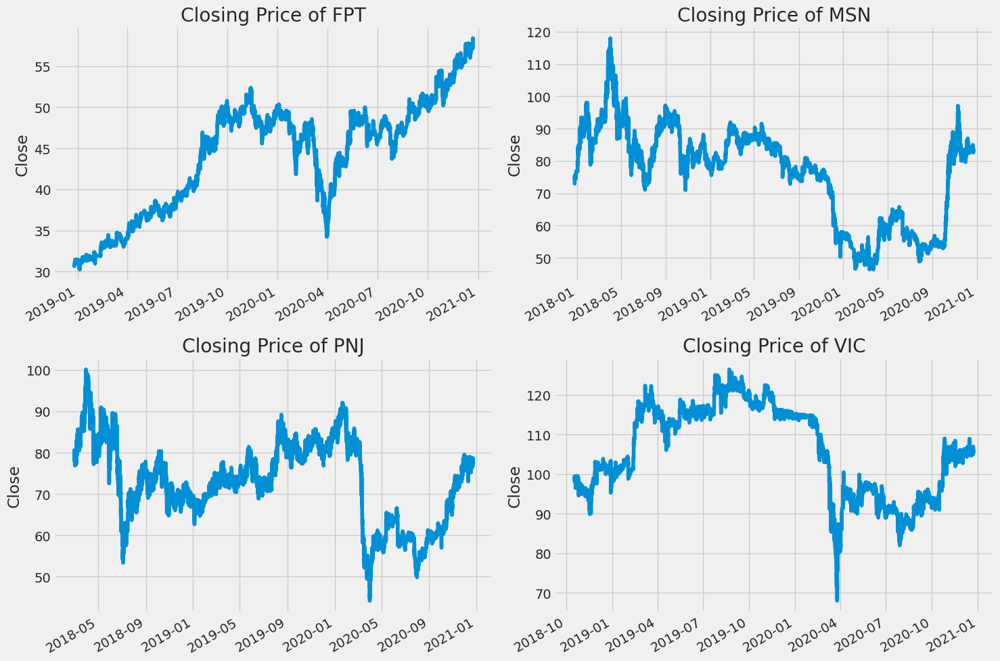

In [13]:
plt.figure(figsize=(15, 10))
plt.subplots_adjust(top=1.25, bottom=1.2)

for i, stock in enumerate(PATH.keys(), 1):
    plt.subplot(2, 2, i)
    globals()[stock]['Close'].plot()
    plt.ylabel('Close')
    plt.xlabel(None)
    plt.title(f"Closing Price of {stock}")
    
plt.tight_layout()

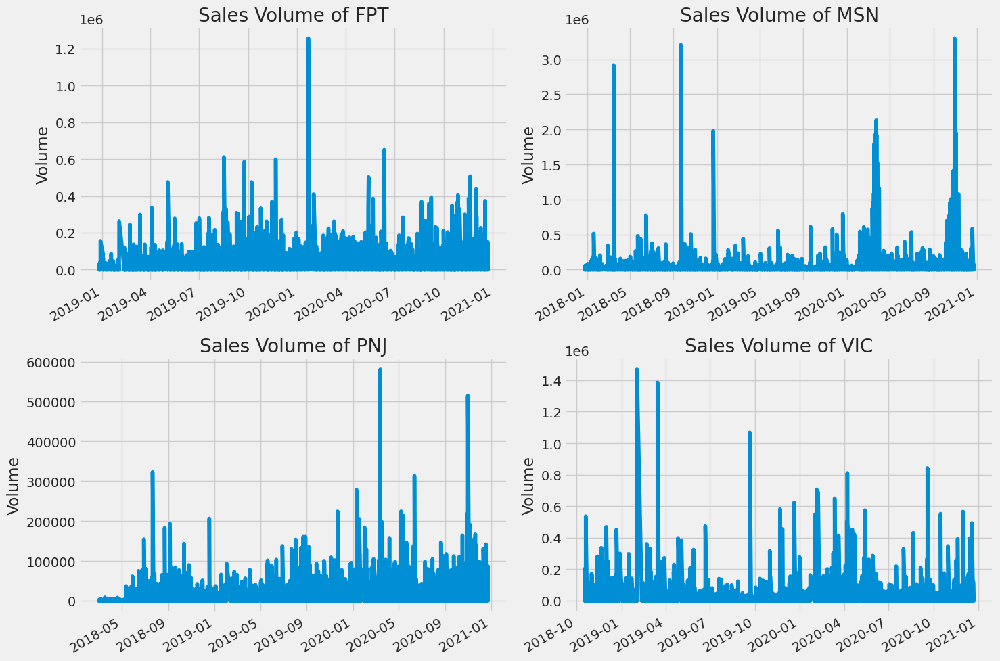

In [14]:
plt.figure(figsize=(15, 10))
plt.subplots_adjust(top=1.25, bottom=1.2)

for i, stock in enumerate(PATH.keys(), 1):
    plt.subplot(2, 2, i)
    globals()[stock]['Volume'].plot()
    plt.ylabel('Volume')
    plt.xlabel(None)

    plt.title(f"Sales Volume of {stock}")
    
plt.tight_layout()

- Chúng ta có thể thấy được, mọi cổ phiếu đều chịu ảnh hưởng nặng nề bởi dịch covid-19 (bắt đầu từ năm 2020) và biến đổi khí hậu toàn cầu.
- Hầu như mọi cổ phiếu đều phát triển bình thường và ổn định trước dịch covid-19 ngoại trừ PNJ.
- Cổ phiếu PNJ giảm nặng nề trong mốc thời gian năm 2018 bởi vì những sự thay đổi mới chuyển mình dẫn đến 'Sự cố ERP'
- Ngoài ra chỉ có cổ phiếu FPT là có sự khác biệt trong quá trình phát triển dù bị ảnh hưởng bởi dịch bệnh nhưng với bản chất là tập đoàn công nghệ và sự phát triển công nghệ thời đại chuyển đổi số, FPT vẫn phát triển mạnh mẽ giá cổ phiếu tăng

**REFERENCES:**
- General Statistics Office of Vietnam. (2021, January). Kinh tế Việt Nam 2020: Một năm tăng trưởng đầy bản lĩnh. Retrieved June 29, 2024, from https://www.gso.gov.vn/du-lieu-va-so-lieu-thong-ke/2021/01/kinh-te-viet-nam-2020-mot-nam-tang-truong-day-ban-linh/

- Phu Nhuan Jewelry. (n.d.). Nhìn lại PNJ sau "sự cố ERP": Không có sự chuyển đổi nào là dễ dàng, nhất là với một doanh nghiệp lớn! Retrieved June 29, 2024, from https://tuyendung.pnj.com.vn/tin-tuc/ban-tin-pnj/nhin-lai-pnj-sau-su-co-erp-khong-co-su-chuyen-doi-nao-la-de-dang-nhat-la-voi-mot-doanh-nghiep-lon-.35a53c82/vi

**Câu hỏi 02:** Đường trung bình động (Moving Averages) của các cổ phiếu nên được đo lường với độ dài như thế nào?

In [15]:
distances = [1, 60, 1000, 4000]
title_distances = ['Per 1', 'Per 60', 'Per 1000', 'Per 4000']

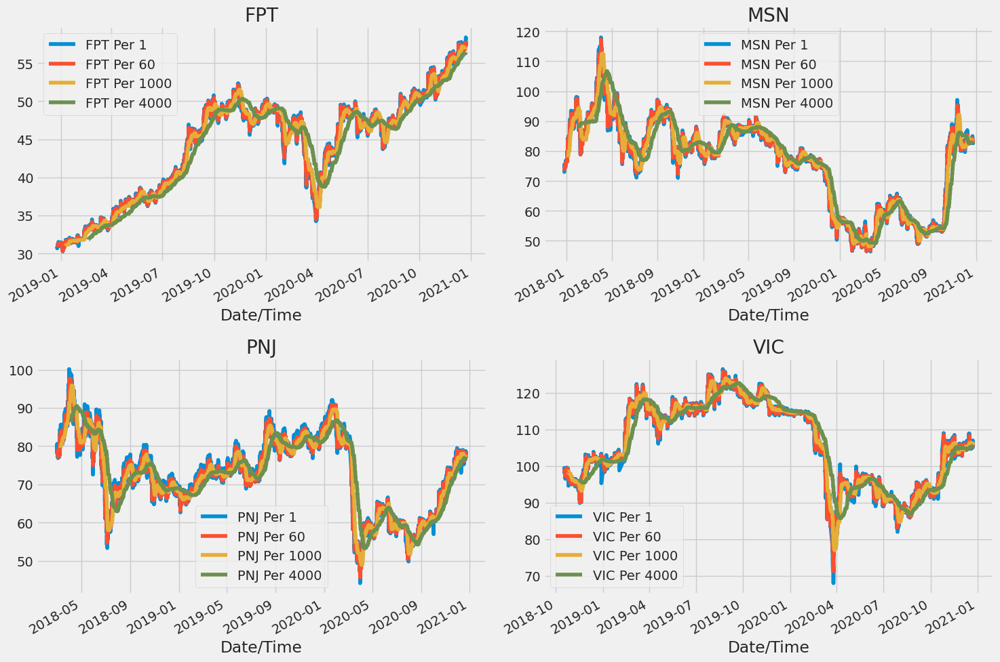

In [16]:
for i in range (len(distances)):
    for stock in PATH.keys():
        globals()[stock][f'{stock} {title_distances[i]}'] = globals()[stock]['Close'].rolling(distances[i]).mean()
        
fig, axes = plt.subplots(nrows=2, ncols=2)
fig.set_figheight(10)
fig.set_figwidth(15)

FPT[['FPT Per 1', 'FPT Per 60', 'FPT Per 1000', 'FPT Per 4000']].plot(ax=axes[0,0])
axes[0,0].set_title('FPT')

MSN[['MSN Per 1', 'MSN Per 60', 'MSN Per 1000', 'MSN Per 4000']].plot(ax=axes[0,1])
axes[0,1].set_title('MSN')

PNJ[['PNJ Per 1', 'PNJ Per 60', 'PNJ Per 1000', 'PNJ Per 4000']].plot(ax=axes[1,0])
axes[1,0].set_title('PNJ')

VIC[['VIC Per 1', 'VIC Per 60', 'VIC Per 1000', 'VIC Per 4000']].plot(ax=axes[1,1])
axes[1,1].set_title('VIC')

fig.tight_layout()

- Giá trị tốt nhất của độ dài để đo lường đường trung bình động là 60 cho đến 1000 bởi vì những thước đo vẫn nắm bắt được xu hướng của dữ liệu mà không có nhiễu

**Câu hỏi 03:** Rủi ro của giá các cổ phiếu như thế nào?

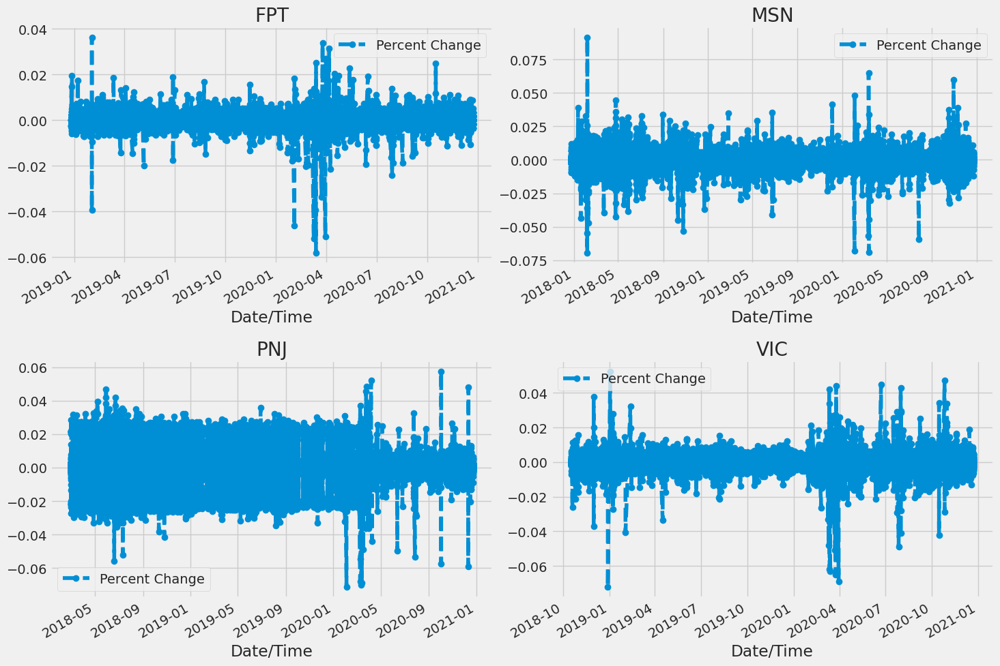

In [17]:
# change percent
for stock in PATH.keys():
    globals()[stock]['Percent Change'] = globals()[stock]['Close'].pct_change()
    
fig, axes = plt.subplots(nrows=2, ncols=2)
fig.set_figheight(10)
fig.set_figwidth(15)

FPT[['Percent Change']].plot(ax=axes[0,0], legend=True, linestyle='--', marker='o')
axes[0,0].set_title('FPT')
MSN[['Percent Change']].plot(ax=axes[0,1], legend=True, linestyle='--', marker='o')
axes[0,1].set_title('MSN')
PNJ[['Percent Change']].plot(ax=axes[1,0], legend=True, linestyle='--', marker='o')
axes[1,0].set_title('PNJ')
VIC[['Percent Change']].plot(ax=axes[1,1], legend=True, linestyle='--', marker='o')
axes[1,1].set_title('VIC')

fig.tight_layout()

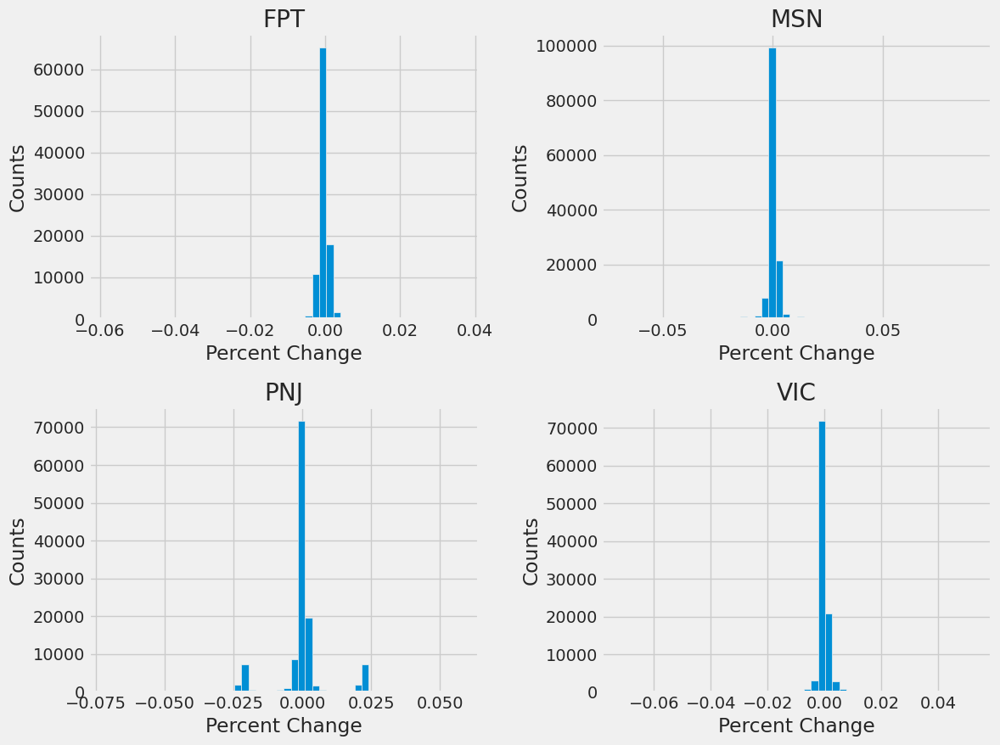

In [18]:
plt.figure(figsize=(12, 9))

for i, stock in enumerate(PATH.keys(), 1):
    plt.subplot(2, 2, i)
    globals()[stock]['Percent Change'].hist(bins=50)
    plt.xlabel('Percent Change')
    plt.ylabel('Counts')
    plt.title(f'{stock}')
    
plt.tight_layout()

- Bởi vì ảnh hưởng dịch bệnh, biến đổi khí hậu, khủng hoảng kinh tế toàn cầu cho nên có rất nhiều sự biến động không ổn định và rủi ro rất cao. Vì vậy có rất nhiều outliers.

**Câu hỏi 04:** Sự tương quan giữa các giá cổ phiếu khác nhau như thế nào?

In [19]:
all_stocks_close = pd.concat([FPT[['Close']],MSN[['Close']],PNJ[['Close']],VIC[['Close']]], axis=1)
all_stocks_close.columns = ['FPT', 'MSN', 'PNJ', 'VIC']
all_stocks_close.head(3)

,FPT,MSN,PNJ,VIC
Date/Time,,,,
2017-12-25 09:15:00,NaN,73.1,NaN,NaN
2017-12-25 09:16:00,NaN,73.0,NaN,NaN
2017-12-25 09:18:00,NaN,73.5,NaN,NaN


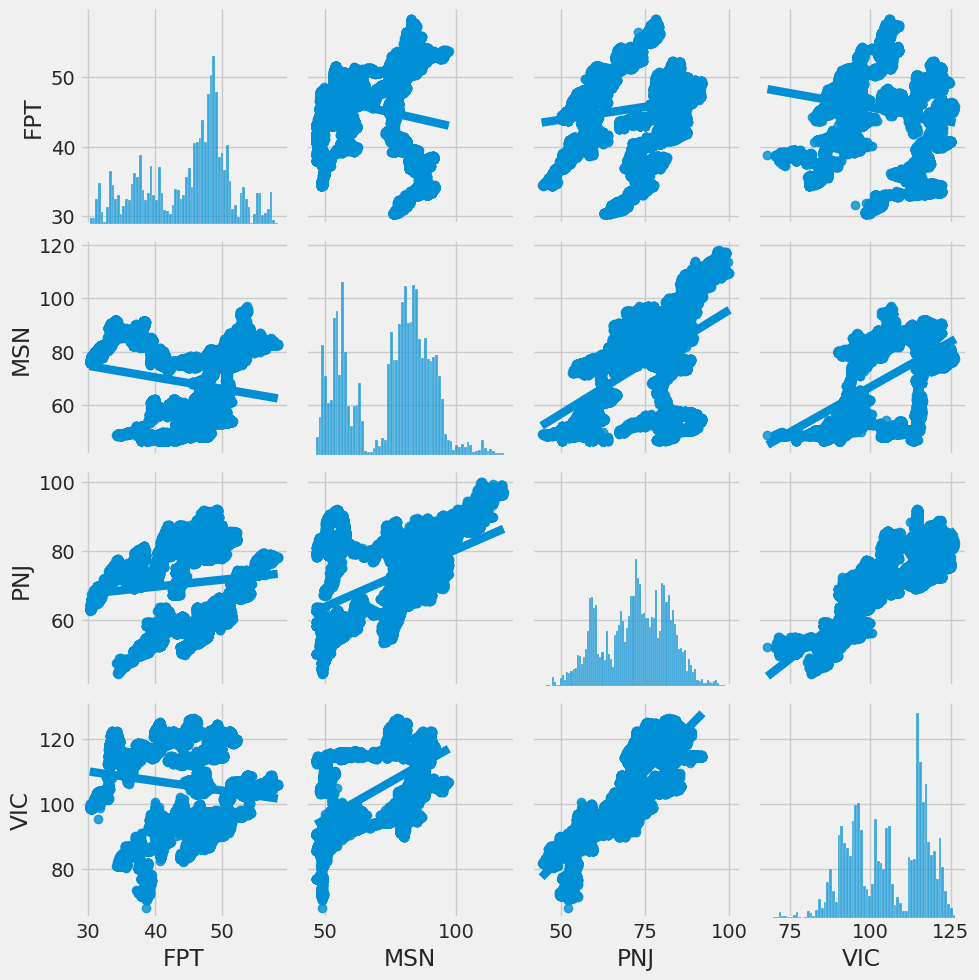

In [20]:
sns.pairplot(all_stocks_close, kind='reg')

Text(0.5, 1.0, 'Correlation of stock closing price')

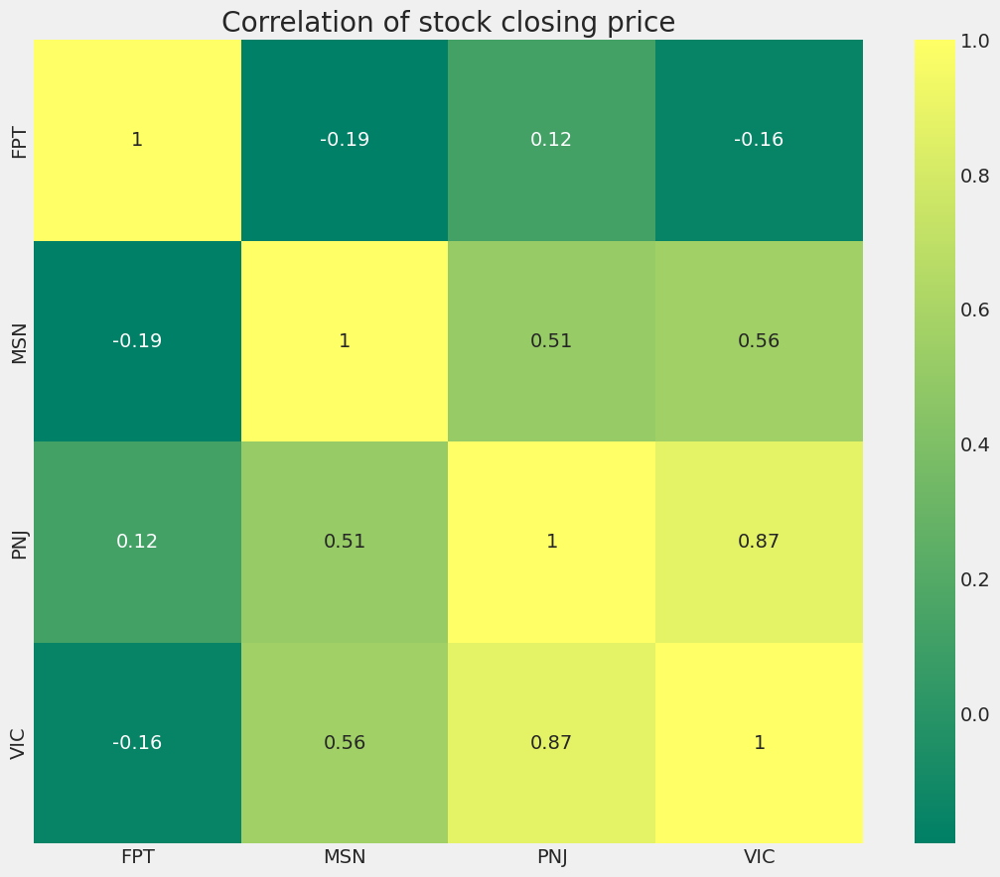

In [21]:
plt.figure(figsize=(12, 10))
sns.heatmap(all_stocks_close.corr(), annot=True, cmap='summer')
plt.title('Correlation of stock closing price')

Ngoài trừ FPT thì giá các cổ phiếu khác có sự tương quan khá cao. Đặc biệt là PNJ và VIC!

**Câu hỏi 05:** Sự biến động của giá đóng cửa như thế nào?

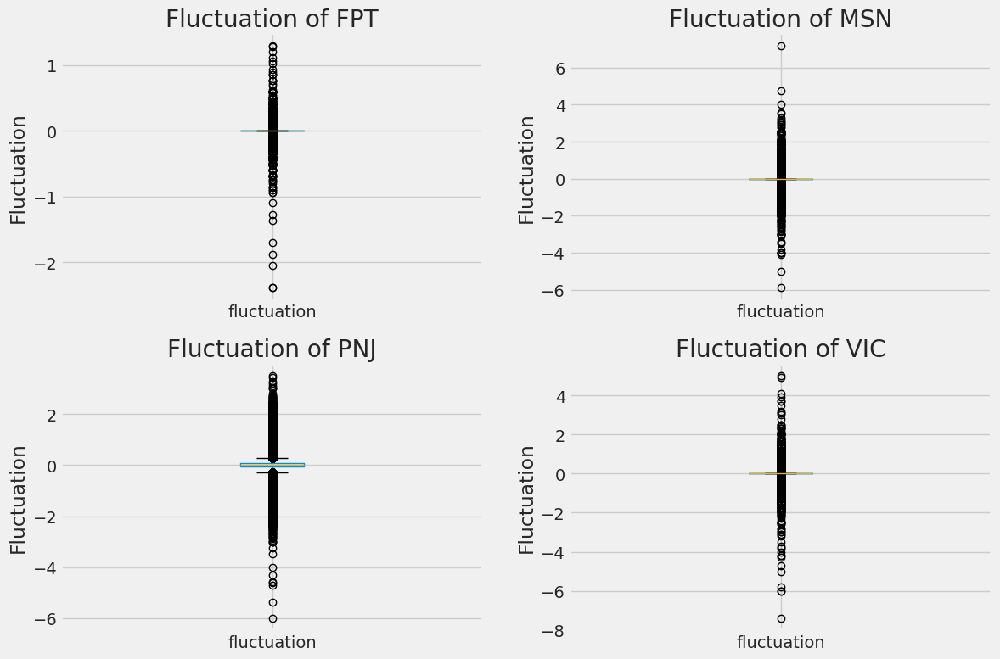

In [22]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12, 8))

for i, stock in enumerate(PATH.keys()):
    row = i // 2
    col = i % 2
    globals()[stock]['fluctuation'] = globals()[stock]['Close'].shift(-1) - globals()[stock]['Close']
    ax = axes[row, col]
    globals()[stock][['fluctuation']].boxplot(ax=ax)
    ax.set_title(f"Fluctuation of {stock}")
    ax.set_ylabel('Fluctuation')
    
plt.tight_layout()
plt.show()

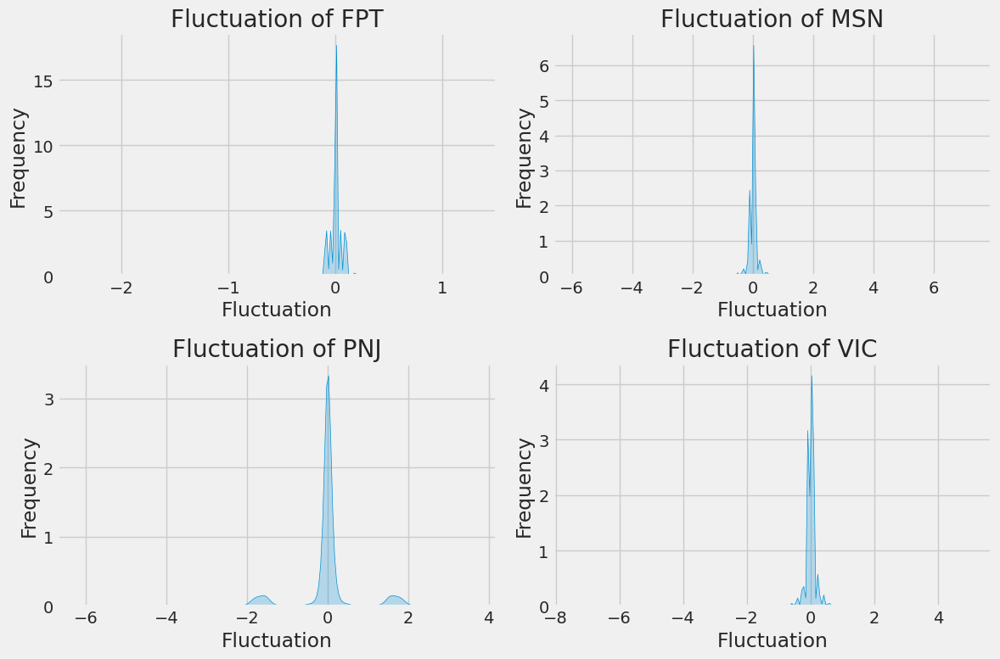

In [23]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12, 8))

for i, stock in enumerate(PATH.keys()):
    row = i // 2
    col = i % 2
    ax = axes[row, col]    
    sns.kdeplot(globals()[stock]['fluctuation'], ax=ax, fill=True)
    ax.set_title(f"Fluctuation of {stock}")
    ax.set_xlabel('Fluctuation')
    ax.set_ylabel('Frequency')
    
plt.tight_layout()
plt.show()

**Câu 06:** Sự mua bán quá mức diễn ra như thế nào? 

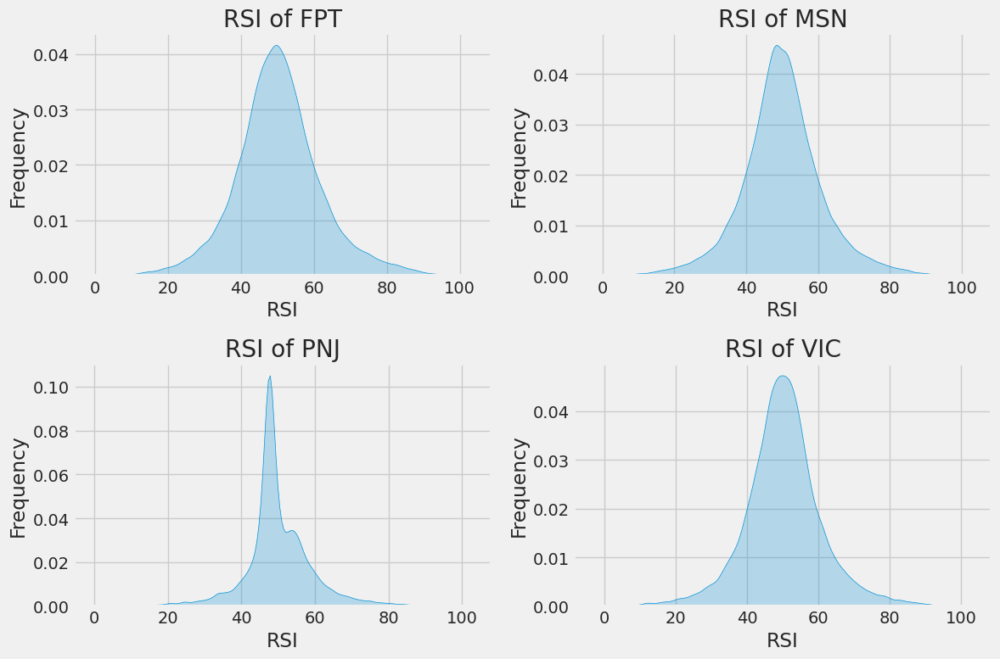

In [24]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12, 8))

for i, stock in enumerate(PATH.keys()):
    row = i // 2
    col = i % 2
    ax = axes[row, col]
    globals()[stock]['RSI'] = ta.momentum.rsi( globals()[stock]['Close'], window=60)
    sns.kdeplot(globals()[stock]['RSI'], ax=ax, fill=True)
    ax.set_title(f"RSI of {stock}")
    ax.set_xlabel('RSI')
    ax.set_ylabel('Frequency')
    
plt.tight_layout()
plt.show()

# 2. Data Preprocessing

In [25]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

In [26]:
def get_cleaned_df(stock_name, sample_title='15T'):
    df = pd.read_csv(PATH[stock_name], parse_dates=['Date/Time'])
    df.set_index('Date/Time', inplace=True)
    df.drop(columns=['Ticker','Open Interest', 'Volume'],inplace=True)
#     ohlcv_dict = {'Open': 'first',
#         'High': 'max',
#         'Low': 'min',
#         'Close': 'last',
#         'Volume': 'sum'
#     }
#     df = df.resample(sample_title).agg(ohlcv_dict).interpolate()
    df.dropna(inplace=True)
    return df

def features_extract(df):
    # RSI a day
    df['RSI'] = ta.momentum.rsi(df['Close'], window=60)
    # EMAF (Exponential Moving Average Fast)
    df['EMAF'] = ta.ema(df.Close, length=60)
    # EMAM (Exponential Moving Average Medium)
    df['EMAM'] = ta.ema(df.Close, length=560)
    # EMAS (Exponential Moving Average Slow)
    df['EMAS'] = ta.ema(df.Close, length=1000)
    # Target
    df['Target'] = df['Close'] - df['Open']
    df['Target'] = df['Target'].shift(-1)
    
    # Target class: Increase of Decrease
    df['TargetClass'] = [1 if df['Target'].iloc[i]>0 else 0 for i in range(len(df))]
    
    # Target next close
    df['TargetNextClose'] = df['Close'].shift(-1)
    
    df.dropna(inplace=True)
    df.reset_index(inplace = True)
    df.drop(['Date/Time'], axis=1, inplace=True)
    return df

def create_sliding_windows(data, window_size):
    X = []
    for j in range(8):
        X.append([])
        for i in range(window_size, data.shape[0]):
            X[j].append(data[i-window_size:i,j])
            
    # Move axis 0 to pos 2
    X = np.moveaxis(X, [0], [2])
    
    X,yi = np.array(X), np.array(data[window_size:,-1])
    y = np.reshape(yi, (len(yi),1))
    return X,y

def preprocessing(df, window_size):
    df_scaled = scaler.fit_transform(df)
    X,y = create_sliding_windows(df_scaled, window_size)
    return X, y

In [27]:
# data for VIC
df = get_cleaned_df('VIC')
df = features_extract(df)
df.head(3)

,Open,High,Low,Close,RSI,EMAF,EMAM,EMAS,Target,TargetClass,TargetNextClose
0,99.1,99.1,99.1,99.1,46.652915,99.105587,98.641016,98.511900,0.0,0,99.1
1,99.1,99.1,99.1,99.1,46.652915,99.105404,98.642653,98.513075,-0.1,0,99.1
2,99.2,99.2,99.1,99.1,46.652915,99.105227,98.644283,98.514248,0.0,0,99.2


In [28]:
# Data preprocessing for VIC
WINDOW_SIZE = 32
X,y = preprocessing(df, window_size=WINDOW_SIZE)
X.shape, y.shape

((100234, 32, 8), (100234, 1))

In [29]:
splitlimit1 = int(len(X) * 0.8)
X_train, X_temp = X[:splitlimit1], X[splitlimit1:]
y_train, y_temp = y[:splitlimit1], y[splitlimit1:]

splitlimit2 = int(len(X_temp) * 0.5)
X_valid, X_test = X_temp[:splitlimit2], X_temp[splitlimit2:]
y_valid, y_test = y_temp[:splitlimit2], y_temp[splitlimit2:]

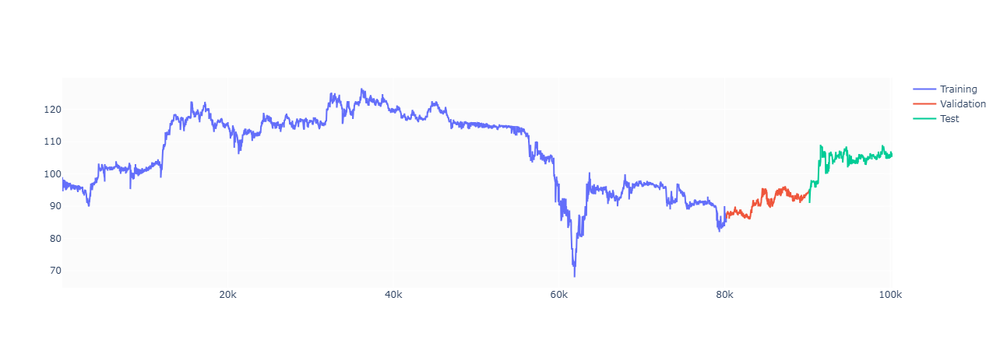

In [30]:
train_df  = df.loc[WINDOW_SIZE:splitlimit1+WINDOW_SIZE].copy()
valid_df  = df.loc[WINDOW_SIZE + splitlimit1:splitlimit1 + splitlimit2].copy()
test_df   = df.loc[WINDOW_SIZE + splitlimit1 + splitlimit2:].copy()

fig = go.Figure()
fig.add_trace(go.Scatter(x=train_df.index, y=train_df.TargetNextClose, name='Training'))
fig.add_trace(go.Scatter(x=valid_df.index, y=valid_df.TargetNextClose, name='Validation'))
fig.add_trace(go.Scatter(x=test_df.index,  y=test_df.TargetNextClose,  name='Test'))
fig.show()

# 3. Modeling and Training

# 3.1 LSTM

In [31]:
import tensorflow as tf
import keras
from keras import optimizers
from keras.callbacks import History
from keras.models import Model
from keras.layers import Dense, LSTM, Input, Activation
from tensorflow.keras.callbacks import Callback, ModelCheckpoint, LearningRateScheduler, TensorBoard, EarlyStopping, ReduceLROnPlateau
np.random.seed(10)

2024-07-02 10:52:00.195660: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-02 10:52:00.195748: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-02 10:52:00.336704: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [32]:
lstm_input = Input(shape=(WINDOW_SIZE, 8), name='lstm_input')
inputs = LSTM(300, name='first_layer')(lstm_input)
inputs = Dense(1, name='dense_layer')(inputs)
output = Activation('linear', name='output')(inputs)
lstm_model = Model(inputs=lstm_input, outputs=output)
adam = optimizers.Adam()
lstm_model.compile(optimizer=adam, loss='mse')
lstm_model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_input (InputLayer)         │ (None, 32, 8)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ first_layer (LSTM)              │ (None, 300)            │       370,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_layer (Dense)             │ (None, 1)              │           301 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Activation)             │ (None, 1)              │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 371,101 (1.42 MB)

 Trainable params: 371,101 (1.42 MB)

 Non-trainable params: 0 (0.00 B)

In [33]:
start_lr = 0.00001
min_lr = 0.00001
max_lr = 0.00005
batch_size = 15


rampup_epochs = 5
sustain_epochs = 0
exp_decay = .8

def lrfn(epoch):
    if epoch < rampup_epochs:
        return (max_lr - start_lr)/rampup_epochs * epoch + start_lr
    elif epoch < rampup_epochs + sustain_epochs:
        return max_lr
    else:
        return (max_lr - min_lr) * exp_decay**(epoch-rampup_epochs-sustain_epochs) + min_lr


lr_callback = LearningRateScheduler(lambda epoch: lrfn(epoch), verbose=0)

checkpoint_filepath = './weights.weights.h5'


model_checkpoints = ModelCheckpoint(filepath=checkpoint_filepath,
                                        save_weights_only=True,
                                        monitor='val_loss',
                                        mode='min',
                                        save_best_only=True)

early_stopping = EarlyStopping(patience = 4, monitor='val_loss', 
                               mode='min', restore_best_weights=True)

my_callbacks = [
    model_checkpoints,
    lr_callback,
    early_stopping,   
]

In [34]:
history = lstm_model.fit(
    x=X_train,
    y=y_train,
    batch_size=batch_size,
    epochs=30,
    shuffle=True, 
    validation_data=(X_valid, y_valid),
    callbacks=my_callbacks
)

Epoch 1/30
5346/5346 ━━━━━━━━━━━━━━━━━━━━ 26s 4ms/step - loss: 0.0299 - val_loss: 3.3191e-05 - learning_rate: 1.0000e-05
Epoch 2/30
5346/5346 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - loss: 4.7623e-05 - val_loss: 1.5916e-05 - learning_rate: 1.8000e-05
Epoch 3/30
5346/5346 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - loss: 3.1715e-05 - val_loss: 1.6418e-05 - learning_rate: 2.6000e-05
Epoch 4/30
5346/5346 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - loss: 2.6419e-05 - val_loss: 1.4667e-05 - learning_rate: 3.4000e-05
Epoch 5/30
5346/5346 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - loss: 2.4312e-05 - val_loss: 1.3694e-05 - learning_rate: 4.2000e-05
Epoch 6/30
5346/5346 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - loss: 2.2601e-05 - val_loss: 1.4136e-05 - learning_rate: 5.0000e-05
Epoch 7/30
5346/5346 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - loss: 2.0876e-05 - val_loss: 1.1964e-05 - learning_rate: 4.2000e-05
Epoch 8/30
5346/5346 ━━━━━━━━━━━━━━━━━━━━ 22s 4ms/step - loss: 2.0555e-05 - val_loss: 1.7526e-05 - learning_rate: 3.5600e-05
Epoc

# 3.2 Transformer (Encoder)

In [35]:
# Building Transformer and Training
import math
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [36]:
class PositionalEncoding(nn.Module):
    
    def __init__(self, max_length_seq:int, d_model:int, dropout_rate:float):
        super(PositionalEncoding, self).__init__()
        den = torch.exp(- torch.arange(0, d_model, 2)* math.log(10000) / d_model)
        pos = torch.arange(0, max_length_seq).reshape(max_length_seq, 1)
        PE = torch.zeros((max_length_seq, d_model))
        PE[:, 0::2] = torch.sin(pos * den)
        PE[:, 1::2] = torch.cos(pos * den)
        PE = PE.unsqueeze(-2)
        self.register_buffer("PE", PE)
        self.dropout_layer = nn.Dropout(dropout_rate)
        
    def forward(self, token_embedding: torch.Tensor):
        return self.dropout_layer(token_embedding + self.PE[:token_embedding.size(0), :])
    
class TransformerModel(nn.Module):
    def __init__(self,
                 input_dim=8, 
                 d_model=36, 
                 nhead=4, 
                 num_layers=1, 
                 dropout=0.2):
        super(TransformerModel,self).__init__()
        # Input Preprocessing (Just need a linear instead of Token Embedding)
        self.token_embedding = nn.Linear(input_dim, d_model)
        # Positional Encoding
        self.positional_encoding = PositionalEncoding(max_length_seq=100,d_model=d_model,dropout_rate=dropout) 
        
        # Transformer Architecture with Encoder
        encoder_layers = nn.TransformerEncoderLayer(d_model, nhead)
        self.transformer_encoder = nn.TransformerEncoder(encoder_layers, num_layers)
        self.encoder_out = nn.Linear(d_model, 1)
    
    def forward(self, x):
        x = self.token_embedding(x)
        x = self.positional_encoding(x)
        x = self.transformer_encoder(x)
        x = self.encoder_out(x[:, -1, :])
        return x
    
transformer_model = TransformerModel().to(device)

In [37]:
# Setting
# Initializing the weights of paramaters which have more than a dimension
for p in transformer_model.parameters():
    if p.dim() > 1:
        nn.init.xavier_uniform_(p)

# Loss
criterion = nn.MSELoss()

# Optimize
optimizer = torch.optim.Adam(transformer_model.parameters(), lr=0.0001, betas=(0.9, 0.98), eps=1e-9)

# EarlyStopping
class EarlyStopping():
    def __init__(self, tolerance=5, min_delta=0):

        self.tolerance = tolerance
        self.min_delta = min_delta
        self.counter = 0
        self.early_stop = False

    def __call__(self, train_loss, validation_loss):
        if (validation_loss - train_loss) > self.min_delta:
            self.counter +=1
            if self.counter >= self.tolerance:  
                self.early_stop = True
                
earlystopping  = EarlyStopping(tolerance=5, min_delta=0.1)

In [38]:
# DataLoader
train_dataset = TensorDataset(torch.tensor(X_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.float32))
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

valid_dataset = TensorDataset(torch.tensor(X_valid, dtype=torch.float32), torch.tensor(y_valid, dtype=torch.float32))
valid_loader = DataLoader(valid_dataset, batch_size=32, shuffle=False)

test_dataset = TensorDataset(torch.tensor(X_test, dtype=torch.float32), torch.tensor(y_test, dtype=torch.float32))
test_loader = DataLoader(test_dataset, batch_size=10, shuffle=False)

In [39]:
# Training
EPOCH = 30
history = {
    'loss':[],
    'val_loss':[]
}

for epoch in range(EPOCH):
    print(f"Epoch {epoch+1}: ",end='')
    transformer_model.train()
    train_losses = []
    for x, y in train_loader:
        x = x.to(device)
        y = y.to(device)
        
        # Reset grad
        optimizer.zero_grad()
        
        # predict
        outputs = transformer_model(x)
        loss = criterion(outputs, y)
        train_losses.append(loss.item())
        loss.backward()
        optimizer.step()
    train_loss = np.mean(train_losses)
    history['loss'].append(train_loss)
    print(f"Loss: {train_loss:.4e} ",end='')
    # Validation
    transformer_model.eval()
    val_losses = []
    with torch.no_grad():
        for x, y in valid_loader:
            x = x.to(device)
            y = y.to(device)
            outputs = transformer_model(x)
            loss = criterion(outputs, y)
            val_losses.append(loss.item())
    val_loss = np.mean(val_losses)
    history['val_loss'].append(val_loss)
    print(f"- Val_loss: {val_loss:.4e} ")
    
    # EarylyStopping
    earlystopping(train_loss, val_loss)
    if earlystopping.early_stop:
        print("Early Stopping active!")
        break

Epoch 1: Loss: 1.3337e-02 - Val_loss: 2.2116e-04 
Epoch 2: Loss: 2.6939e-03 - Val_loss: 1.7282e-04 
Epoch 3: Loss: 1.9040e-03 - Val_loss: 1.5725e-04 
Epoch 4: Loss: 1.4767e-03 - Val_loss: 3.0221e-04 
Epoch 5: Loss: 1.1884e-03 - Val_loss: 1.5726e-04 
Epoch 6: Loss: 1.0524e-03 - Val_loss: 8.0301e-04 
Epoch 7: Loss: 9.5690e-04 - Val_loss: 4.9203e-04 
Epoch 8: Loss: 8.5292e-04 - Val_loss: 3.2116e-04 
Epoch 9: Loss: 7.7864e-04 - Val_loss: 1.2386e-03 
Epoch 10: Loss: 7.3258e-04 - Val_loss: 1.4263e-03 
Epoch 11: Loss: 6.9174e-04 - Val_loss: 7.4681e-04 
Epoch 12: Loss: 6.5831e-04 - Val_loss: 1.1914e-03 
Epoch 13: Loss: 6.1582e-04 - Val_loss: 3.1567e-04 
Epoch 14: Loss: 5.9792e-04 - Val_loss: 1.0434e-03 
Epoch 15: Loss: 5.8069e-04 - Val_loss: 5.2042e-04 
Epoch 16: Loss: 5.3392e-04 - Val_loss: 8.0503e-04 
Epoch 17: Loss: 5.2314e-04 - Val_loss: 7.0933e-04 
Epoch 18: Loss: 4.8544e-04 - Val_loss: 1.3668e-03 
Epoch 19: Loss: 4.6892e-04 - Val_loss: 8.9684e-04 
Epoch 20: Loss: 4.4036e-04 - Val_loss: 5

# 4. Testing

**LSTM**

In [40]:
# LSTM predict
lstm_pred = lstm_model.predict(X_test)

# Inverse Transform
temp = test_df.copy()
temp['TargetNextClose'] = lstm_pred[:,0]
lstm_pred = scaler.inverse_transform(temp)[:,-1]
target = lstm_pred - test_df.Open

314/314 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


In [41]:
lstm_pred

array([ 94.74933939,  94.76042938,  94.66503032, ..., 105.73833939,
       105.70962849, 105.70724347])

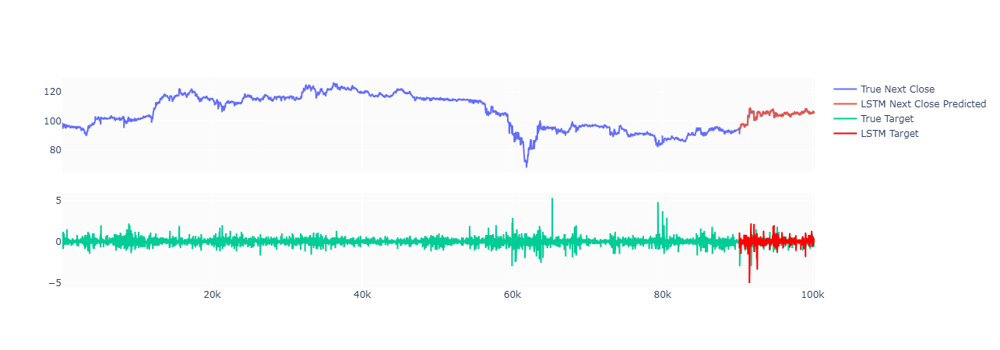

In [42]:
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.1)

fig.add_trace(go.Scatter(x=df.iloc[WINDOW_SIZE:].index, y=df['TargetNextClose'].iloc[WINDOW_SIZE:], name='True Next Close'), row=1, col=1)
fig.add_trace(go.Scatter(x=test_df.index, y=lstm_pred, name='LSTM Next Close Predicted'), row=1, col=1)

fig.add_trace(go.Scatter(x=df.iloc[WINDOW_SIZE:].index, y=df.Target, name='True Target'), row=2, col=1)
fig.add_trace(go.Scatter(x=test_df.index,  y=target,  name='LSTM Target', line=dict(color='red')), row=2, col=1)


fig.show()

**Transformer**

In [43]:
# Transformer predict
transformer_model.eval()
trans_pred = None
with torch.no_grad():
    for x, y in test_loader:
        x = x.to(device)
        y = y.to(device)
        trans_pred = torch.cat((trans_pred, transformer_model(x)), dim=0) if trans_pred != None else transformer_model(x)     

In [44]:
trans_pred = trans_pred.cpu().numpy()
trans_pred.shape

(10024, 1)

In [45]:
# Inverse Transform
temp = test_df.copy()
temp['TargetNextClose'] = trans_pred[:,0]
trans_pred = scaler.inverse_transform(temp)[:,-1]
target = trans_pred - test_df.Open

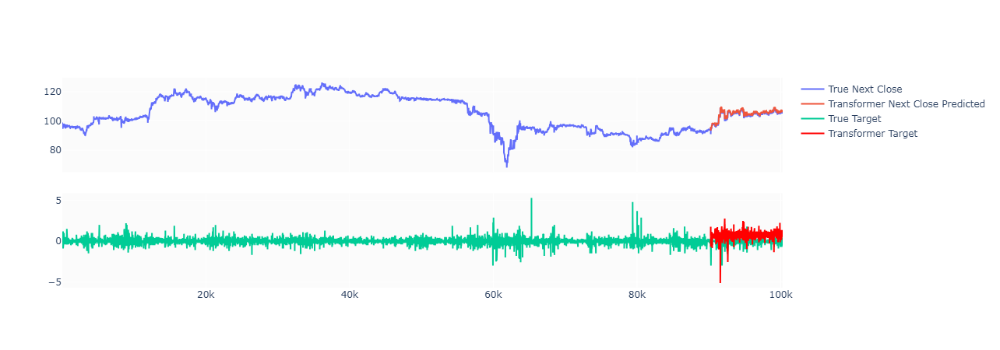

In [46]:
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.1)

fig.add_trace(go.Scatter(x=df.iloc[WINDOW_SIZE:].index, y=df['TargetNextClose'].iloc[WINDOW_SIZE:], name='True Next Close'), row=1, col=1)
fig.add_trace(go.Scatter(x=test_df.index, y=trans_pred, name='Transformer Next Close Predicted'), row=1, col=1)

fig.add_trace(go.Scatter(x=df.iloc[WINDOW_SIZE:].index, y=df.Target, name='True Target'), row=2, col=1)
fig.add_trace(go.Scatter(x=test_df.index,  y=target,  name='Transformer Target', line=dict(color='red')), row=2, col=1)


fig.show()

**So sánh**

In [47]:
# Predict all

# LSTM
lstm_pred = lstm_model.predict(X)
# Inverse Transform
temp = df.iloc[WINDOW_SIZE:,:].copy()
temp['TargetNextClose'] = lstm_pred[:,0]
lstm_pred = scaler.inverse_transform(temp)[:,-1]
lstm_target = lstm_pred - df.iloc[WINDOW_SIZE:,:].Open

# Transformer
X,y = preprocessing(df, window_size=WINDOW_SIZE)
dataset = TensorDataset(torch.tensor(X, dtype=torch.float32), torch.tensor(y, dtype=torch.float32))
loader = DataLoader(dataset, batch_size=10, shuffle=False)
transformer_model.eval()
trans_pred = None
with torch.no_grad():
    for x, y in loader:
        x = x.to(device)
        y = y.to(device)
        trans_pred = torch.cat((trans_pred, transformer_model(x)), dim=0) if trans_pred != None else transformer_model(x)     
# Inverse Transform
trans_pred = trans_pred.cpu().numpy()
temp = df.iloc[WINDOW_SIZE:,:].copy()
temp['TargetNextClose'] = trans_pred[:,0]
trans_pred = scaler.inverse_transform(temp)[:,-1]
trans_target = trans_pred - df.iloc[WINDOW_SIZE:,:].Open

3133/3133 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step


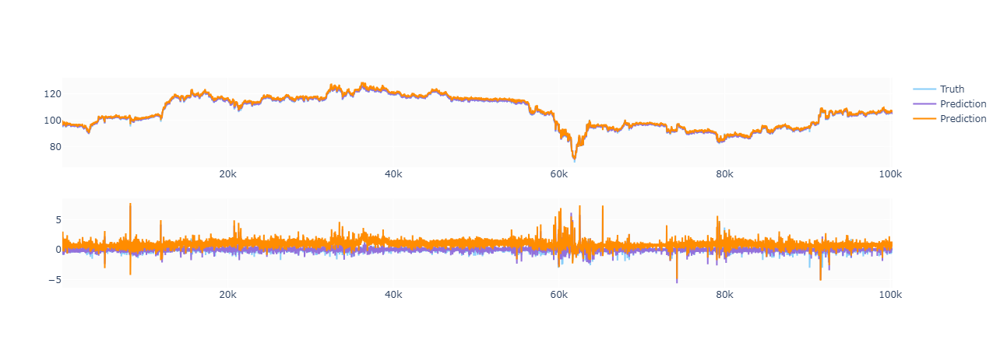

In [48]:
fig = make_subplots(rows=2, cols=1)
fig.add_trace(go.Scatter(x=df.iloc[WINDOW_SIZE:,:].index, y=df.iloc[WINDOW_SIZE:,:].TargetNextClose,
                         name='Truth',
                         marker_color='LightSkyBlue'), row=1, col=1)

fig.add_trace(go.Scatter(x=df.iloc[WINDOW_SIZE:,:].index,
                         y=lstm_pred,
                         name='Prediction',
                         marker_color='MediumPurple'), row=1, col=1)

fig.add_trace(go.Scatter(x=df.iloc[WINDOW_SIZE:,:].index,
                         y=trans_pred,
                         name='Prediction',
                         marker_color='DarkOrange'), row=1, col=1)

fig.add_trace(go.Scatter(x=df.iloc[WINDOW_SIZE:,:].index,
                         y=df.iloc[WINDOW_SIZE:,:].Target,
                         name='Truth',
                         marker_color='LightSkyBlue',
                         showlegend=False), row=2, col=1)

fig.add_trace(go.Scatter(x=df.iloc[WINDOW_SIZE:,:].index,
                         y=lstm_target,
                         name='Prediction',
                         marker_color='MediumPurple',
                         showlegend=False), row=2, col=1)

fig.add_trace(go.Scatter(x=df.iloc[WINDOW_SIZE:,:].index,
                         y=trans_target,
                         name='Prediction',
                         marker_color='DarkOrange',
                         showlegend=False), row=2, col=1)

fig.show()

# 5. Tổng kết

- Với **LSTM**, nhìn chung quá trình huấn luyện và thử nghiệm trên mô hình **LSTM** cho bài toán dự đoán biến động cổ phiếu là rất tốt. **LSTM** đã cho ra sai số rất thấp và kết quả dự đoán đã nắm bắt tổng quát được xu hướng của dữ liệu.
- Với **Transformer (Encoder)**, tuy không đạt được sai số mất mát như **LSTM** tuy nhiên kết quả dự đoán cho thấy mô hình đã nắm bắt xu hướng trên dữ liệu. Tuy nhiên để đạt được sai số bằng hơn hơn **LSTM** ta cần tinh chỉnh các thông số của **Transformer** lại.
- Đề xuất: Sử dụng **LSTM** cho bài toán dự đoán biến động giá cổ phiếu
- Hướng mở rộng: Thử nghiệm trên các mô hình khác như ARIMA, XGBoost,...